# Generative Adversarial Networks

For this part of the assignment you implement two different types of generative adversarial networks. We will train the networks on the Celeb A dataset which is a large set of celebrity face images.

In [1]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [2]:
from gan.train import train

In [3]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# GAN loss functions

In this assignment you will implement two different types of GAN cost functions. You will first implement the loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). You will also implement the loss from [LS-GAN](https://arxiv.org/abs/1611.04076). 

### GAN loss

**TODO:** Implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these are negated from the equations presented earlier as we will be *minimizing* these losses.

**HINTS**: You should use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss. The BCE loss is needed to compute the log probability of the true label given the logits output from the discriminator. Given a score $s\in\mathbb{R}$ and a label $y\in\{0, 1\}$, the binary cross entropy loss is

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [4]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

**TODO:** Implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$


**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`scores_real` and `scores_fake`).

In [5]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

**TODO:** Implement the `Discriminator` and `Generator` networks in `gan/models.py`.

We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Instead of Relu we LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). 

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [6]:
from gan.models import Discriminator, Generator
from gan.utils import show_images

# Data loading: Celeb A Dataset

The CelebA images we provide have been filtered to obtain only images with clear faces and have been cropped and downsampled to 128x128 resolution.

In [7]:
batch_size = 128
scale_size = 64  # We resize the images to 64x64 for training

celeba_root = 'celeba_data'

In [8]:
celeba_train = ImageFolder(root=celeba_root, transform=transforms.Compose([
  transforms.Resize(scale_size),
  transforms.ToTensor(),
]))

celeba_loader_train = DataLoader(celeba_train, batch_size=batch_size, drop_last=True)

### Visualize dataset

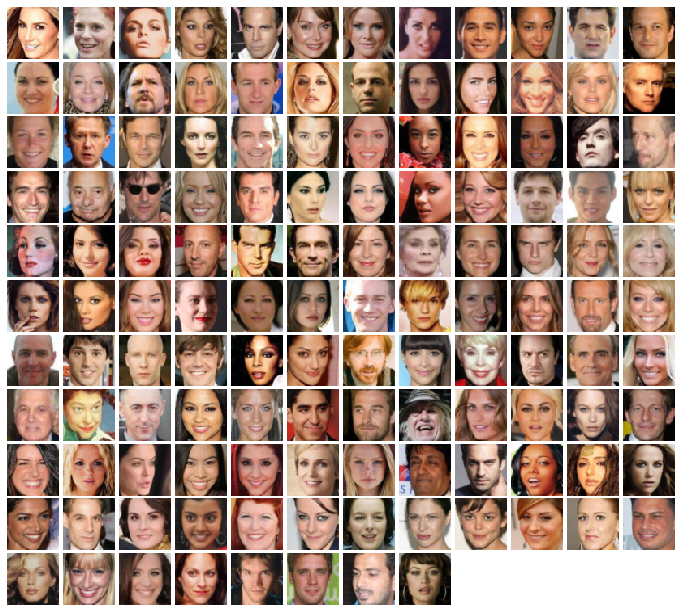

In [9]:
imgs = celeba_loader_train.__iter__().next()[0].numpy().squeeze()
show_images(imgs, color=True)

# Training 


**TODO:** Fill in the training loop in `gan/train.py`.

In [10]:
NOISE_DIM = 100
NUM_EPOCHS = 20
learning_rate = 0.0002

### Train GAN

In [11]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [12]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 1.543, G:2.759


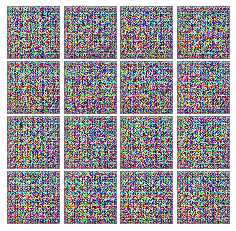


Iter: 150, D: 0.5615, G:1.295


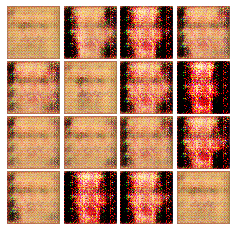


Iter: 300, D: 0.01205, G:5.238


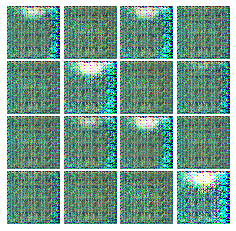


Iter: 450, D: 1.108, G:1.34


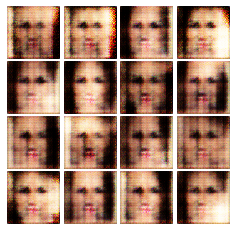


Iter: 600, D: 0.7535, G:1.07


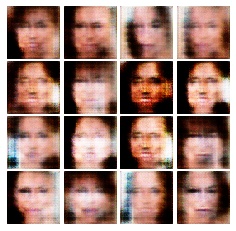


Iter: 750, D: 0.8237, G:1.108


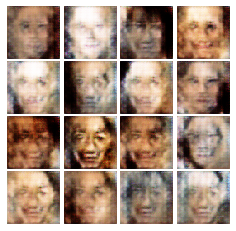


Iter: 900, D: 1.083, G:1.954


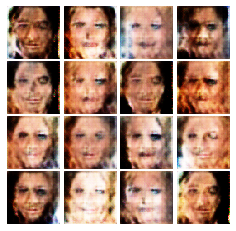


EPOCH:  2
Iter: 1050, D: 0.5142, G:1.226


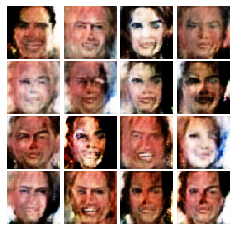


Iter: 1200, D: 1.707, G:2.026


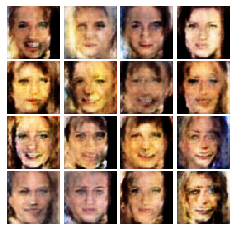


Iter: 1350, D: 1.227, G:1.249


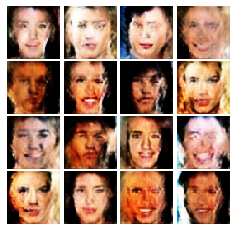


Iter: 1500, D: 0.9043, G:0.9832


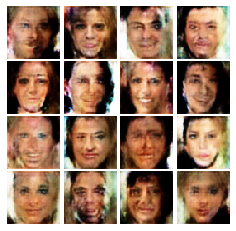


Iter: 1650, D: 0.7717, G:1.258


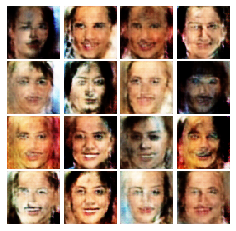


Iter: 1800, D: 0.9391, G:0.8169


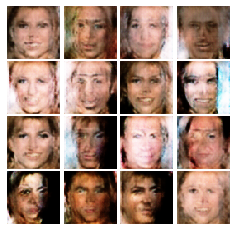


Iter: 1950, D: 0.9628, G:1.593


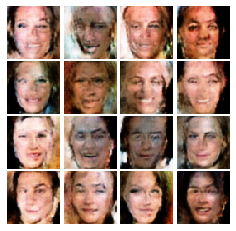


EPOCH:  3
Iter: 2100, D: 1.033, G:0.9187


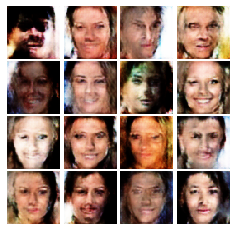


Iter: 2250, D: 1.266, G:1.567


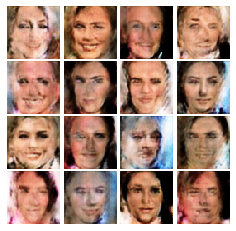


Iter: 2400, D: 1.251, G:1.542


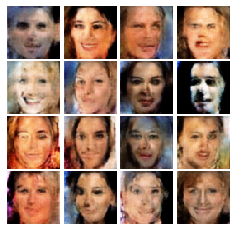


Iter: 2550, D: 0.9436, G:1.171


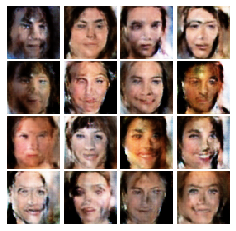


Iter: 2700, D: 1.297, G:0.7337


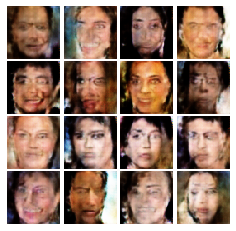


Iter: 2850, D: 0.5956, G:1.073


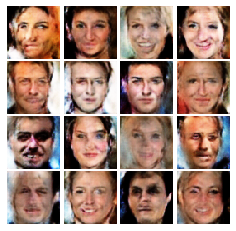


EPOCH:  4
Iter: 3000, D: 1.434, G:2.199


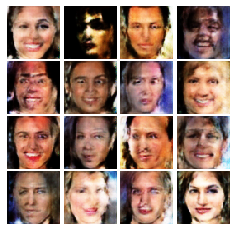


Iter: 3150, D: 1.325, G:1.434


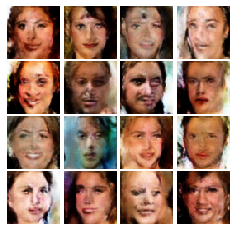


Iter: 3300, D: 1.396, G:1.222


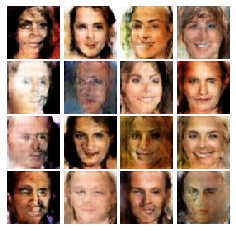


Iter: 3450, D: 1.059, G:0.7426


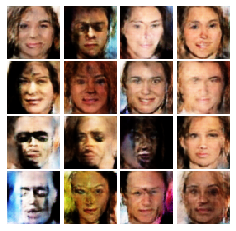


Iter: 3600, D: 0.7047, G:0.7567


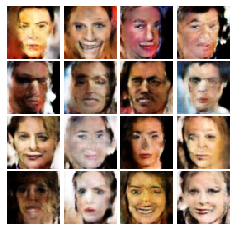


Iter: 3750, D: 0.5455, G:0.7302


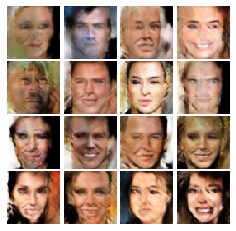


Iter: 3900, D: 0.6252, G:1.051


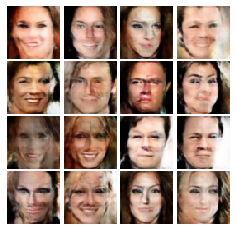


EPOCH:  5
Iter: 4050, D: 0.6549, G:1.019


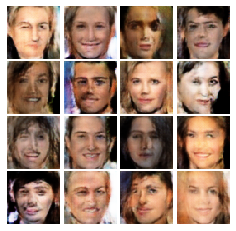


Iter: 4200, D: 1.338, G:1.099


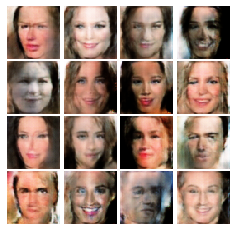


Iter: 4350, D: 0.4872, G:1.127


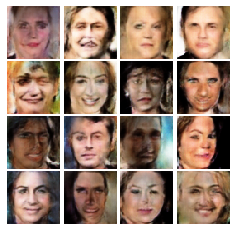


Iter: 4500, D: 1.028, G:0.6636


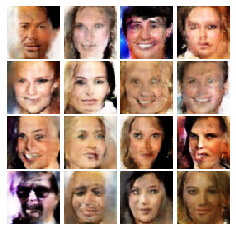


Iter: 4650, D: 1.031, G:1.189


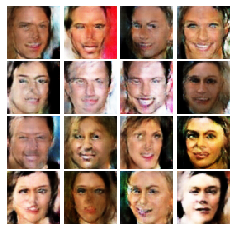


Iter: 4800, D: 1.164, G:0.8608


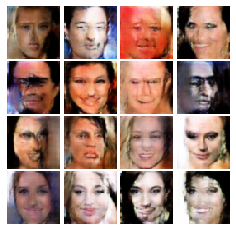


EPOCH:  6
Iter: 4950, D: 0.7319, G:1.072


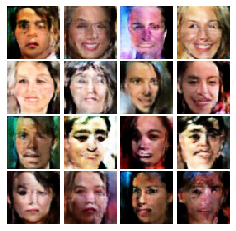


Iter: 5100, D: 1.257, G:1.088


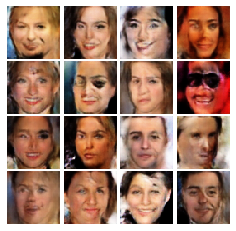


Iter: 5250, D: 0.9862, G:1.145


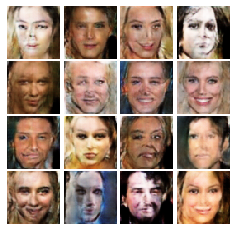


Iter: 5400, D: 0.6166, G:1.135


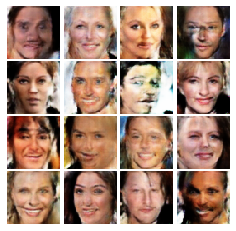


Iter: 5550, D: 0.4633, G:1.083


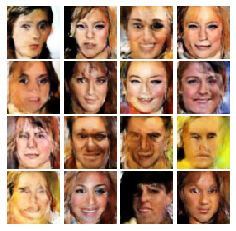


Iter: 5700, D: 1.039, G:1.075


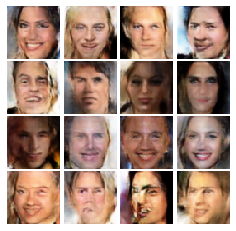


Iter: 5850, D: 0.5596, G:1.049


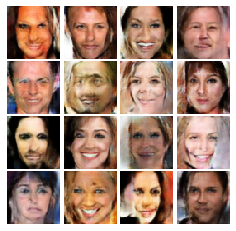


EPOCH:  7
Iter: 6000, D: 0.524, G:0.8026


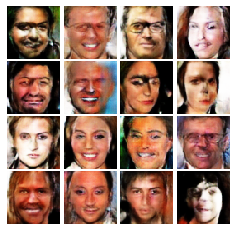


Iter: 6150, D: 0.6361, G:1.076


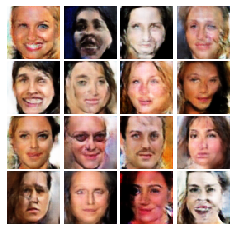


Iter: 6300, D: 0.5233, G:1.197


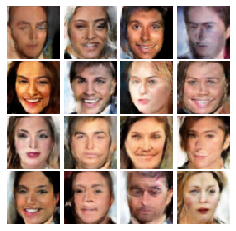


Iter: 6450, D: 0.7826, G:0.9524


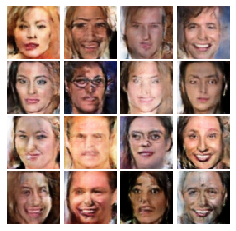


Iter: 6600, D: 1.542, G:1.481


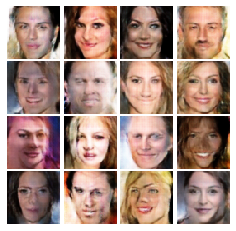


Iter: 6750, D: 1.234, G:1.261


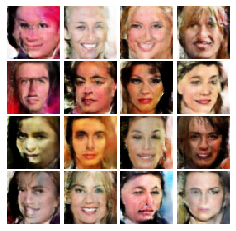


Iter: 6900, D: 1.703, G:2.681


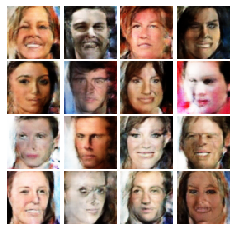


EPOCH:  8
Iter: 7050, D: 0.5066, G:1.437


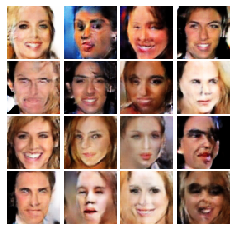


Iter: 7200, D: 1.132, G:0.7176


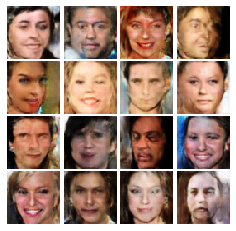


Iter: 7350, D: 0.7355, G:0.9818


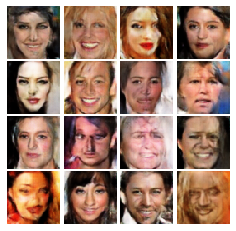


Iter: 7500, D: 0.5939, G:1.386


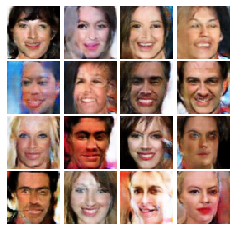


Iter: 7650, D: 0.7087, G:1.665


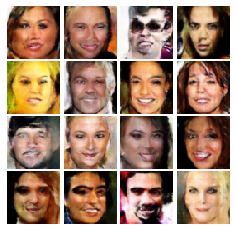


Iter: 7800, D: 1.347, G:2.295


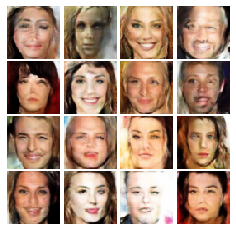


EPOCH:  9
Iter: 7950, D: 0.7346, G:1.04


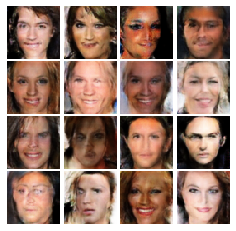


Iter: 8100, D: 0.4809, G:1.46


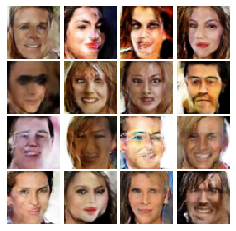


Iter: 8250, D: 0.5705, G:0.9779


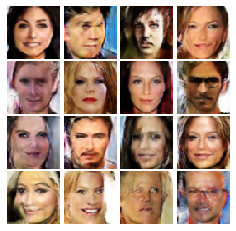


Iter: 8400, D: 0.5832, G:1.137


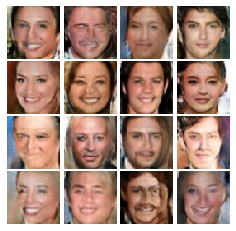


Iter: 8550, D: 1.065, G:1.589


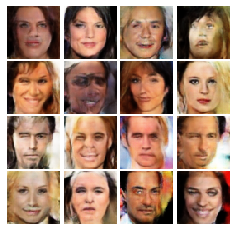


Iter: 8700, D: 1.379, G:1.272


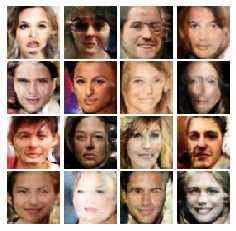


Iter: 8850, D: 1.265, G:1.463


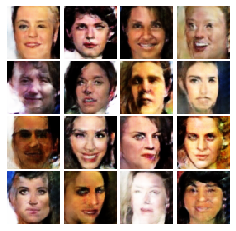


EPOCH:  10
Iter: 9000, D: 0.5694, G:1.164


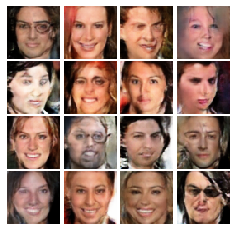


Iter: 9150, D: 0.6854, G:0.9381


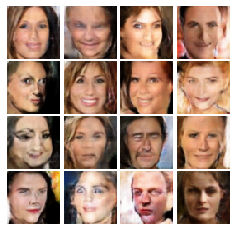


Iter: 9300, D: 0.3347, G:1.272


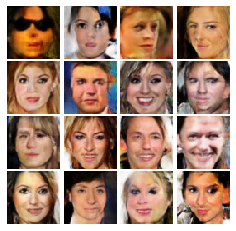


Iter: 9450, D: 0.9787, G:1.929


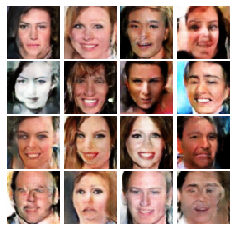


Iter: 9600, D: 0.488, G:1.313


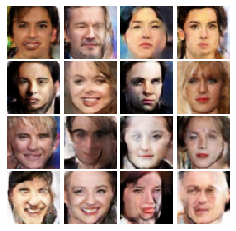


Iter: 9750, D: 0.4398, G:1.549


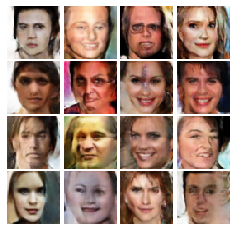


EPOCH:  11
Iter: 9900, D: 0.3907, G:1.756


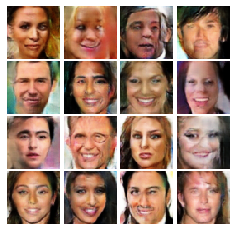


Iter: 10050, D: 1.089, G:1.32


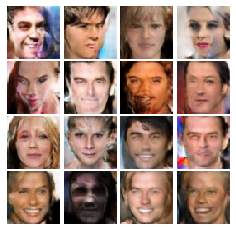


Iter: 10200, D: 0.4683, G:1.431


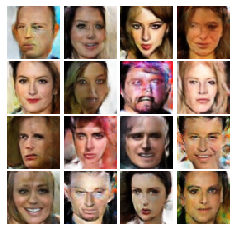


Iter: 10350, D: 0.4017, G:1.64


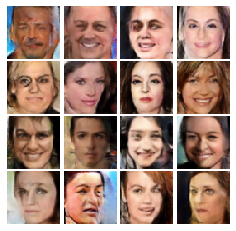


Iter: 10500, D: 1.213, G:1.2


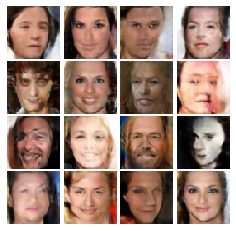


Iter: 10650, D: 0.5479, G:1.855


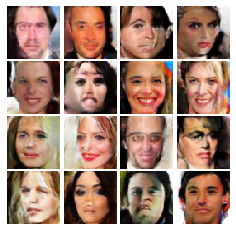


Iter: 10800, D: 1.18, G:1.278


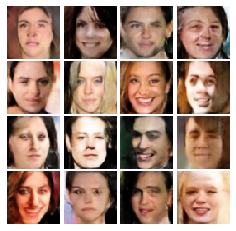


EPOCH:  12
Iter: 10950, D: 0.464, G:1.284


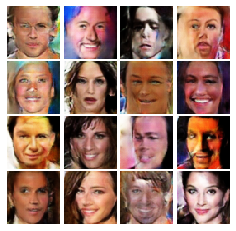


Iter: 11100, D: 0.4106, G:1.42


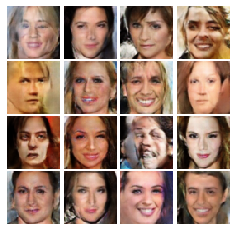


Iter: 11250, D: 0.7007, G:2.341


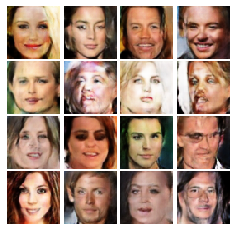


Iter: 11400, D: 0.7409, G:0.8986


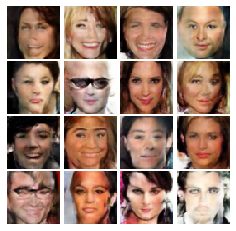


Iter: 11550, D: 0.4189, G:1.958


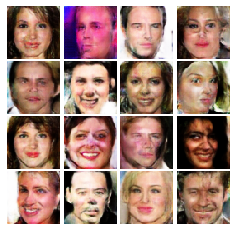


Iter: 11700, D: 0.3132, G:1.64


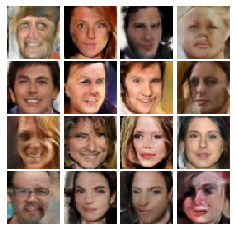


EPOCH:  13
Iter: 11850, D: 0.3712, G:1.695


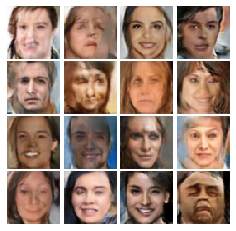


Iter: 12000, D: 1.05, G:1.05


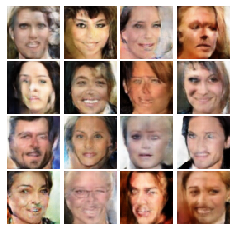


Iter: 12150, D: 1.207, G:1.865


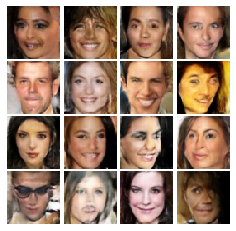


Iter: 12300, D: 0.6707, G:2.194


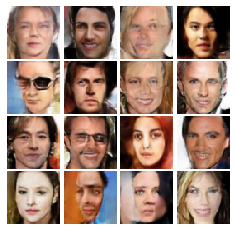


Iter: 12450, D: 0.3699, G:1.739


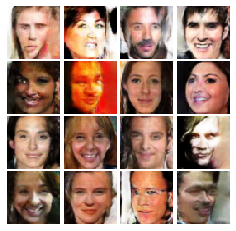


Iter: 12600, D: 0.378, G:1.752


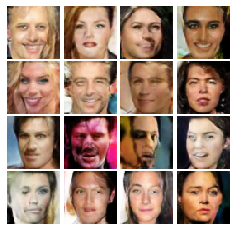


Iter: 12750, D: 1.556, G:2.933


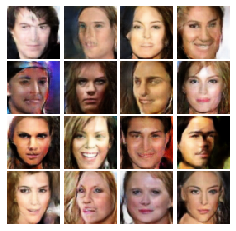


EPOCH:  14
Iter: 12900, D: 0.9168, G:1.708


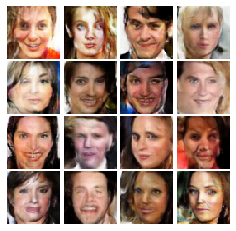


Iter: 13050, D: 0.2503, G:1.879


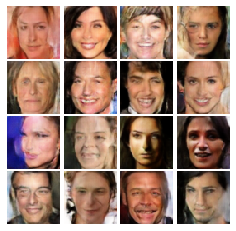


Iter: 13200, D: 1.171, G:0.8342


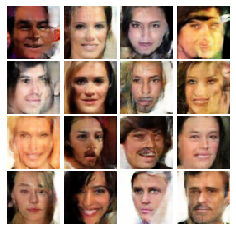


Iter: 13350, D: 2.609, G:2.173


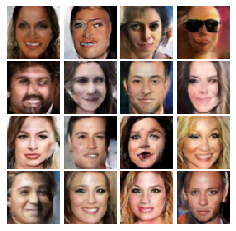


Iter: 13500, D: 0.433, G:1.013


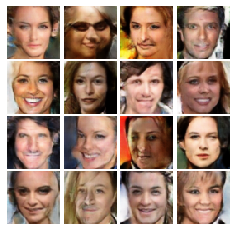


Iter: 13650, D: 0.631, G:0.968


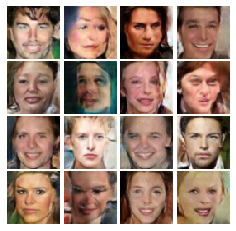


Iter: 13800, D: 0.937, G:1.509


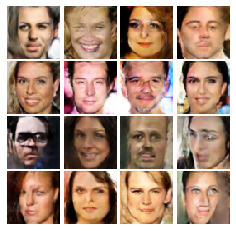


EPOCH:  15
Iter: 13950, D: 0.5269, G:1.112


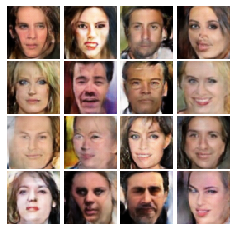


Iter: 14100, D: 1.269, G:1.122


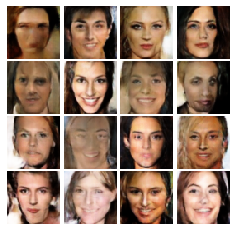


Iter: 14250, D: 0.3654, G:1.606


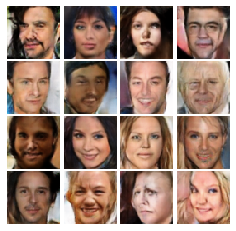


Iter: 14400, D: 0.228, G:2.11


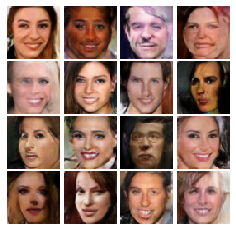


Iter: 14550, D: 0.3451, G:1.512


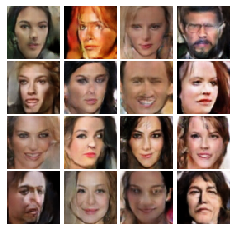


Iter: 14700, D: 1.094, G:1.773


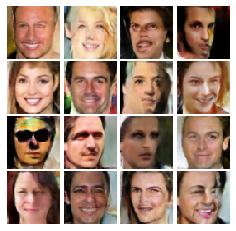


EPOCH:  16
Iter: 14850, D: 0.2018, G:1.876


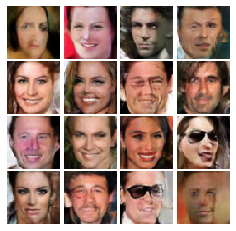


Iter: 15000, D: 0.564, G:1.333


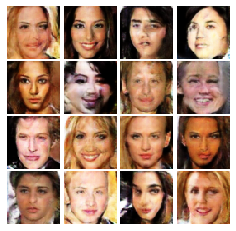


Iter: 15150, D: 0.5336, G:1.489


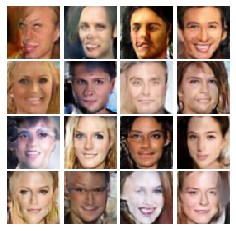


Iter: 15300, D: 0.4521, G:1.168


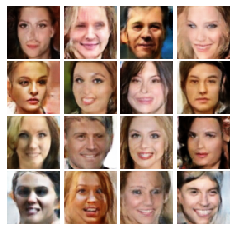


Iter: 15450, D: 0.2629, G:1.339


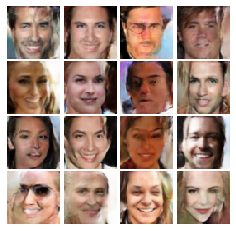


Iter: 15600, D: 1.058, G:0.747


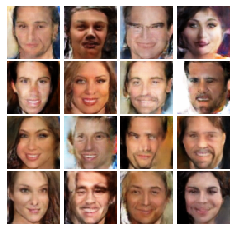


Iter: 15750, D: 0.3545, G:1.15


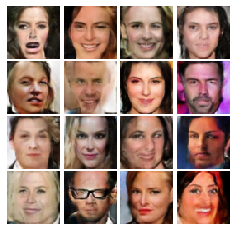


EPOCH:  17
Iter: 15900, D: 0.2195, G:1.794


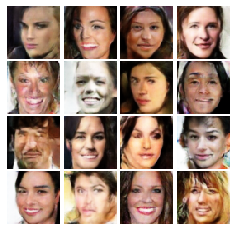


Iter: 16050, D: 1.172, G:1.062


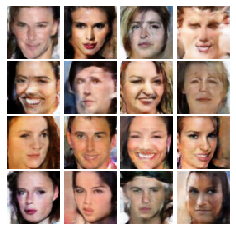


Iter: 16200, D: 0.7253, G:1.11


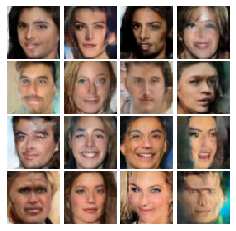


Iter: 16350, D: 0.3298, G:1.46


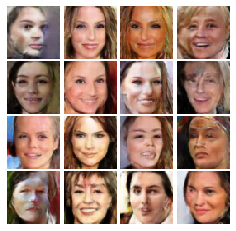


Iter: 16500, D: 1.342, G:1.497


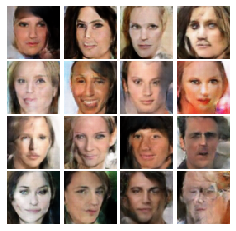


Iter: 16650, D: 0.259, G:1.513


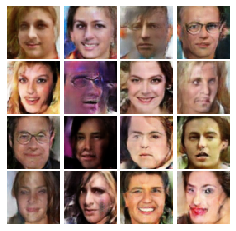


EPOCH:  18
Iter: 16800, D: 0.4178, G:1.565


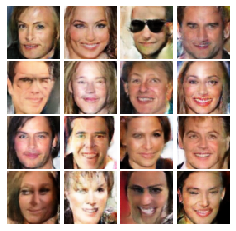


Iter: 16950, D: 0.9917, G:1.212


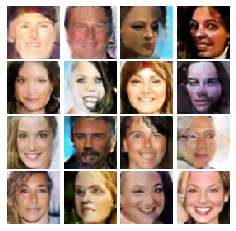


Iter: 17100, D: 0.2953, G:1.782


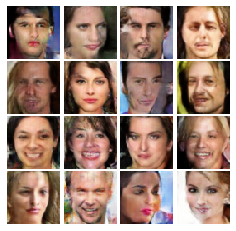


Iter: 17250, D: 1.494, G:1.135


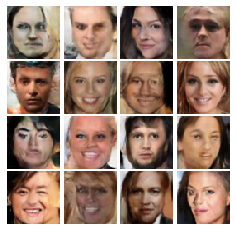


Iter: 17400, D: 0.2761, G:1.834


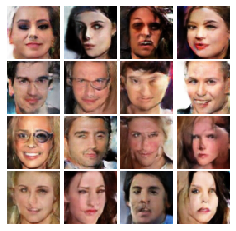


Iter: 17550, D: 0.45, G:1.394


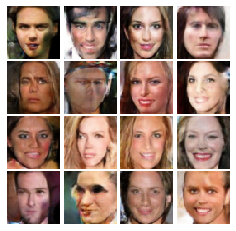


Iter: 17700, D: 1.26, G:0.8007


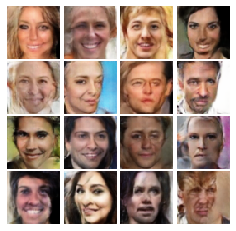


EPOCH:  19
Iter: 17850, D: 0.228, G:2.024


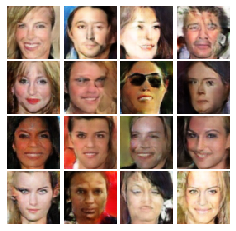


Iter: 18000, D: 0.4801, G:1.002


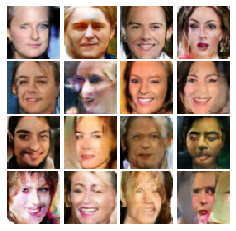


Iter: 18150, D: 0.9162, G:1.072


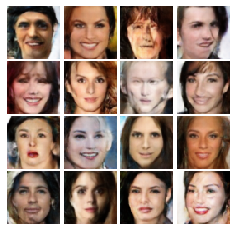


Iter: 18300, D: 1.748, G:2.016


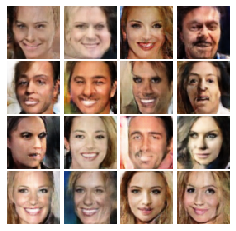


Iter: 18450, D: 0.3705, G:1.326


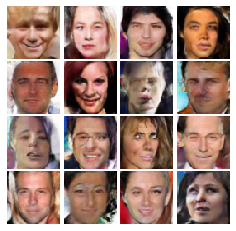


Iter: 18600, D: 0.3481, G:1.108


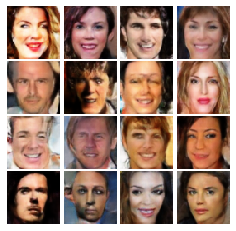


EPOCH:  20
Iter: 18750, D: 0.6183, G:1.48


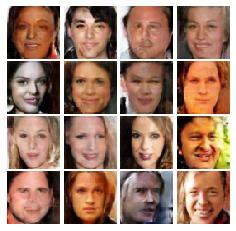


Iter: 18900, D: 0.3744, G:1.538


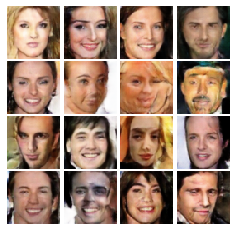


Iter: 19050, D: 0.6754, G:1.046


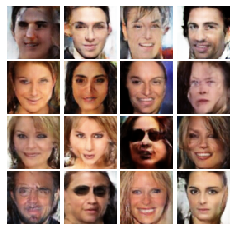


Iter: 19200, D: 0.3237, G:1.868


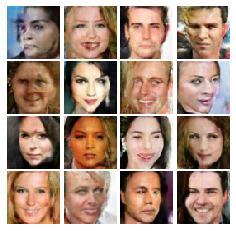


Iter: 19350, D: 0.3645, G:1.589


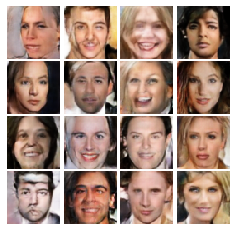


Iter: 19500, D: 1.311, G:1.488


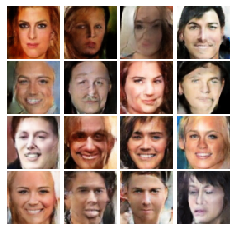


Iter: 19650, D: 0.2561, G:1.87


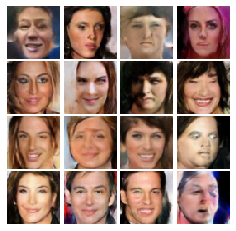

In [13]:
# original gan
train(D, G, D_optimizer, G_optimizer, discriminator_loss, 
          generator_loss, num_epochs=NUM_EPOCHS, show_every=150,
          train_loader=celeba_loader_train, device=device)


### Train LS-GAN

In [14]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [15]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 0.5254, G:3.634


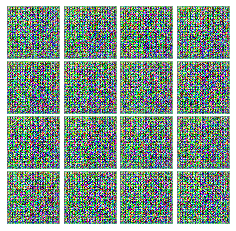


Iter: 200, D: 0.02288, G:0.5574


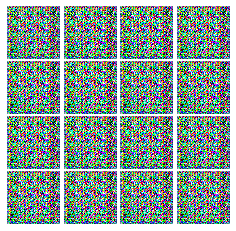


Iter: 400, D: 0.04351, G:0.8176


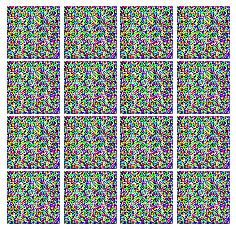


Iter: 600, D: 0.04676, G:0.4857


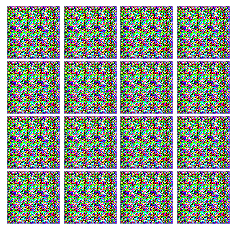


Iter: 800, D: 0.006801, G:0.5193


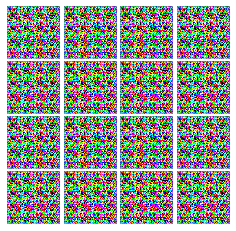


EPOCH:  2
Iter: 1000, D: 0.01964, G:0.7296


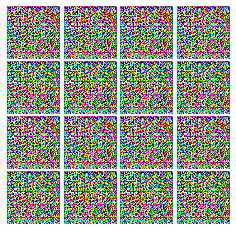


Iter: 1200, D: 0.1498, G:0.555


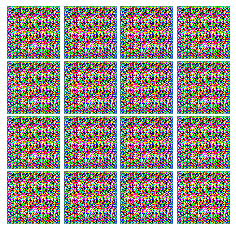


Iter: 1400, D: 0.137, G:0.5902


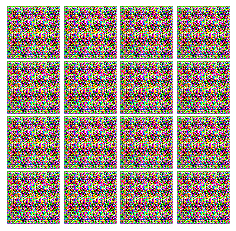


Iter: 1600, D: 0.03109, G:0.5542


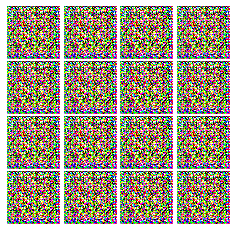


Iter: 1800, D: 0.008993, G:0.4715


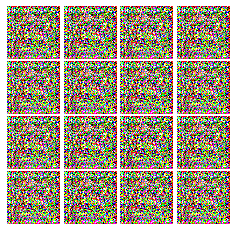


EPOCH:  3
Iter: 2000, D: 0.007535, G:0.5271


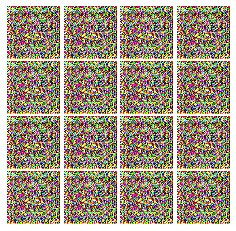


Iter: 2200, D: 0.0205, G:0.6495


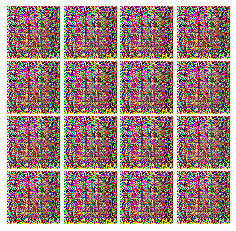


Iter: 2400, D: 0.5858, G:0.6045


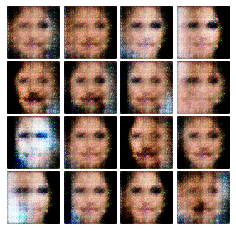


Iter: 2600, D: 0.1951, G:0.3545


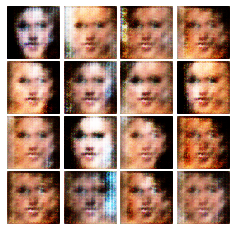


Iter: 2800, D: 0.183, G:0.4483


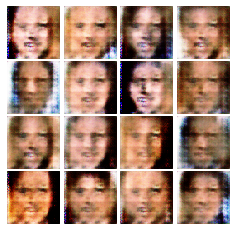


EPOCH:  4
Iter: 3000, D: 0.3161, G:0.2332


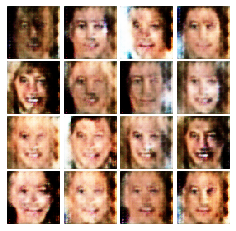


Iter: 3200, D: 0.2106, G:0.3097


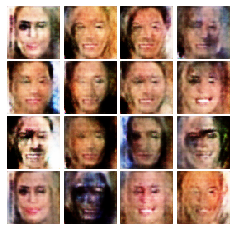


Iter: 3400, D: 0.2115, G:0.3153


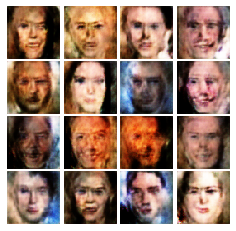


Iter: 3600, D: 0.1975, G:0.2279


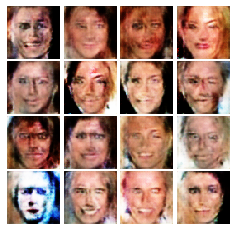


Iter: 3800, D: 0.2158, G:0.3675


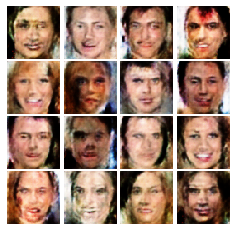


EPOCH:  5
Iter: 4000, D: 0.1895, G:0.3208


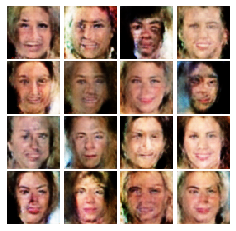


Iter: 4200, D: 0.08542, G:0.3712


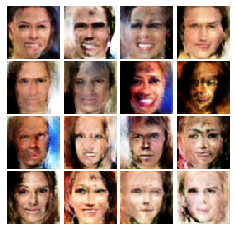


Iter: 4400, D: 0.2062, G:0.3431


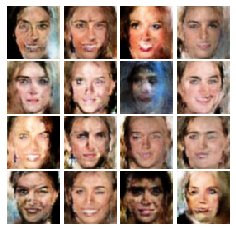


Iter: 4600, D: 0.2276, G:0.2938


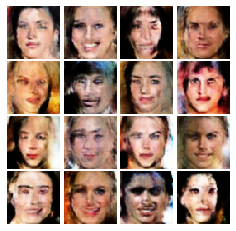


Iter: 4800, D: 0.08204, G:0.4113


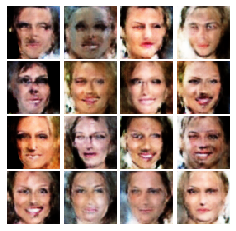


EPOCH:  6
Iter: 5000, D: 0.5406, G:0.6735


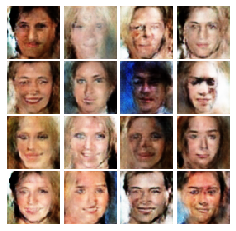


Iter: 5200, D: 0.21, G:0.3246


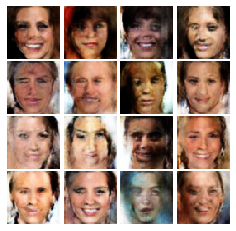


Iter: 5400, D: 0.1892, G:0.1794


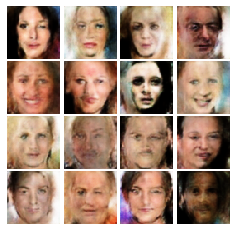


Iter: 5600, D: 0.2153, G:0.1235


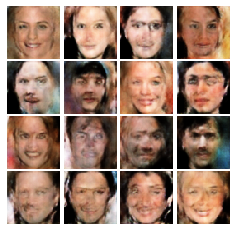


Iter: 5800, D: 0.5133, G:0.5155


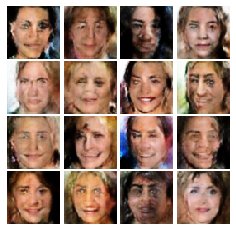


EPOCH:  7
Iter: 6000, D: 0.2589, G:0.322


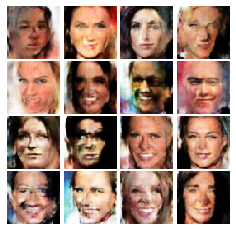


Iter: 6200, D: 0.1652, G:0.3604


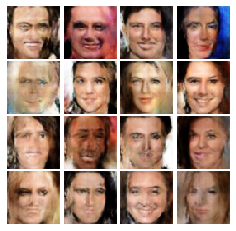


Iter: 6400, D: 0.08283, G:0.5029


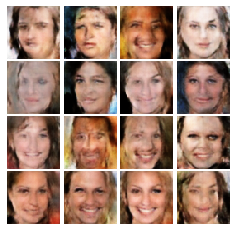


Iter: 6600, D: 0.1788, G:0.3227


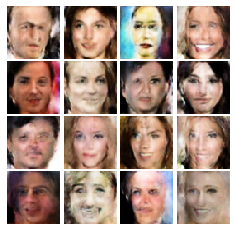


Iter: 6800, D: 0.07226, G:0.4911


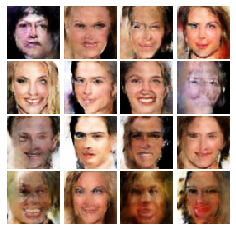


EPOCH:  8
Iter: 7000, D: 0.2429, G:0.4432


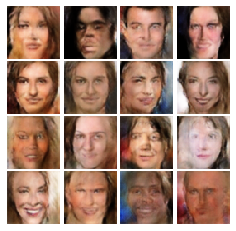


Iter: 7200, D: 0.1316, G:0.5282


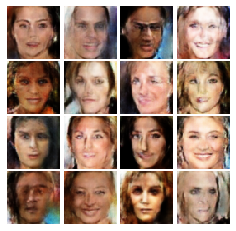


Iter: 7400, D: 0.09715, G:0.4125


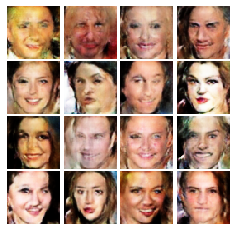


Iter: 7600, D: 0.08896, G:0.5451


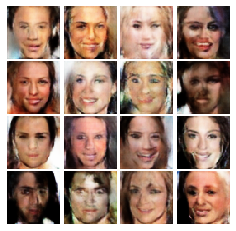


Iter: 7800, D: 0.04882, G:0.4937


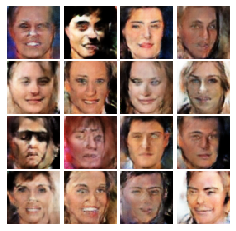


EPOCH:  9
Iter: 8000, D: 0.3014, G:0.3222


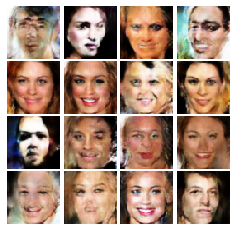


Iter: 8200, D: 0.1195, G:0.5372


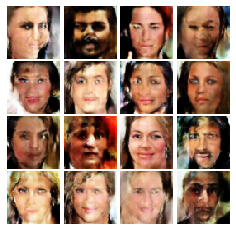


Iter: 8400, D: 0.04297, G:0.4685


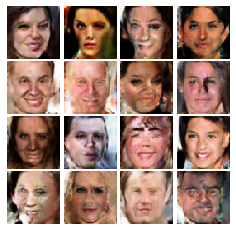


Iter: 8600, D: 0.3446, G:0.6681


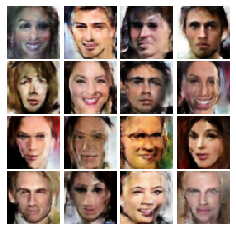


Iter: 8800, D: 0.1208, G:0.6501


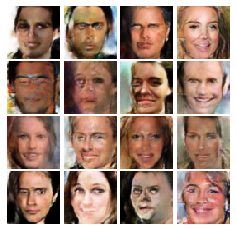


EPOCH:  10
Iter: 9000, D: 0.1187, G:0.3684


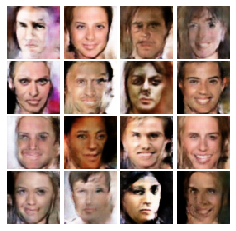


Iter: 9200, D: 0.08208, G:0.3936


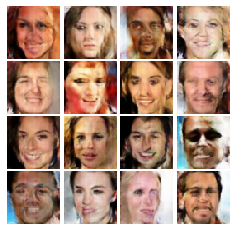


Iter: 9400, D: 0.05752, G:0.5174


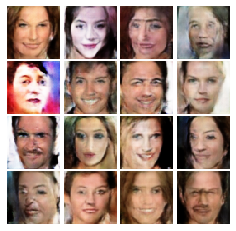


Iter: 9600, D: 0.1205, G:0.3713


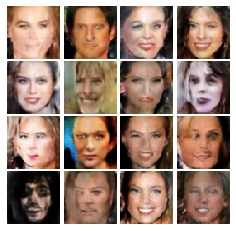


Iter: 9800, D: 0.1075, G:0.4445


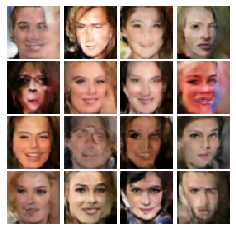


EPOCH:  11
Iter: 10000, D: 0.1027, G:0.2892


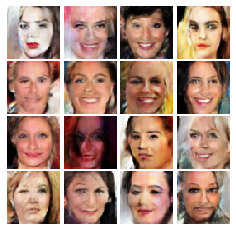


Iter: 10200, D: 0.164, G:0.4009


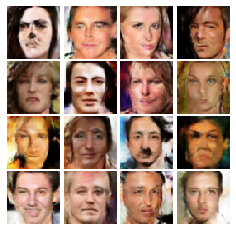


Iter: 10400, D: 0.1577, G:0.56


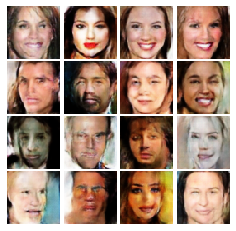


Iter: 10600, D: 0.05891, G:0.4453


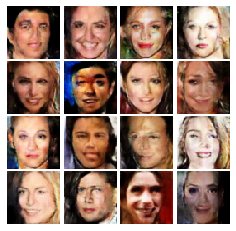


Iter: 10800, D: 0.05878, G:0.559


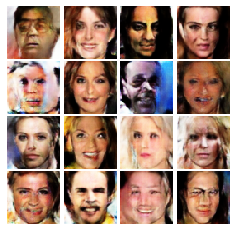


EPOCH:  12
Iter: 11000, D: 0.1269, G:0.305


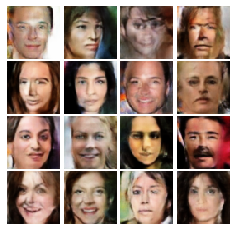


Iter: 11200, D: 0.04214, G:0.5169


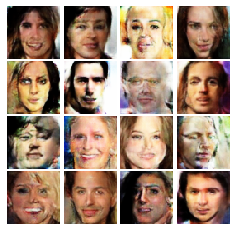


Iter: 11400, D: 0.05531, G:0.5529


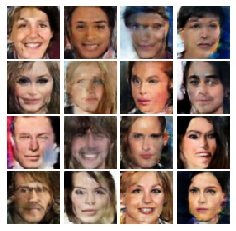


Iter: 11600, D: 0.02767, G:0.3742


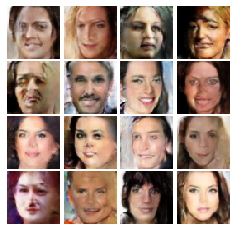


Iter: 11800, D: 0.01799, G:0.4971


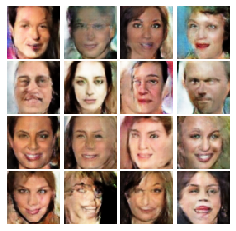


EPOCH:  13
Iter: 12000, D: 0.2156, G:0.2674


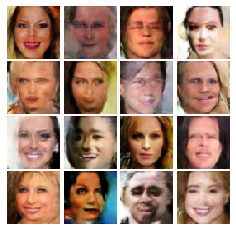


Iter: 12200, D: 0.08018, G:0.4259


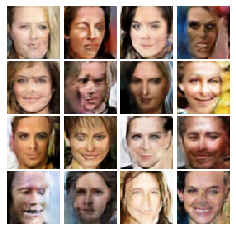


Iter: 12400, D: 0.1614, G:0.2896


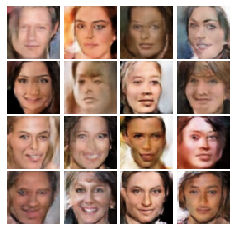


Iter: 12600, D: 0.04971, G:0.4085


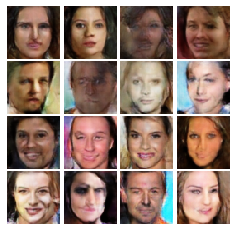


Iter: 12800, D: 0.05039, G:0.5034


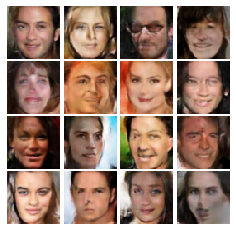


EPOCH:  14
Iter: 13000, D: 0.02857, G:0.5362


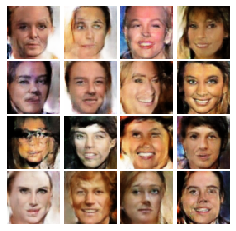


Iter: 13200, D: 0.1347, G:0.4076


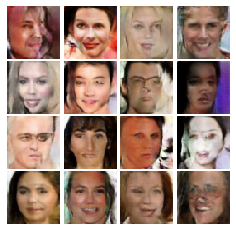


Iter: 13400, D: 0.1422, G:0.4545


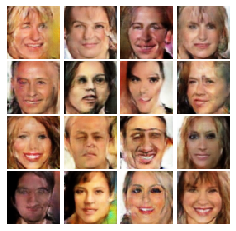


Iter: 13600, D: 0.1072, G:0.5369


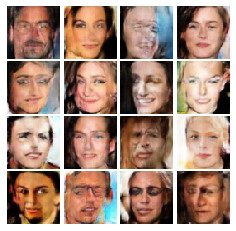


Iter: 13800, D: 0.01677, G:0.2951


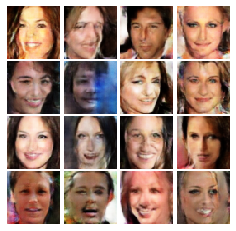


EPOCH:  15
Iter: 14000, D: 0.1321, G:0.4893


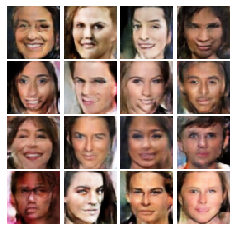


Iter: 14200, D: 0.08802, G:0.3729


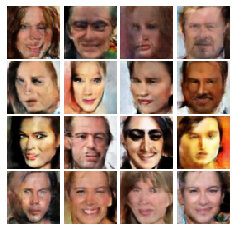


Iter: 14400, D: 0.09352, G:0.4652


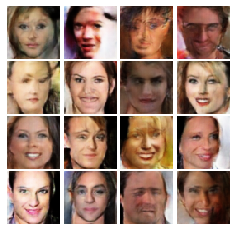


Iter: 14600, D: 0.1755, G:0.6691


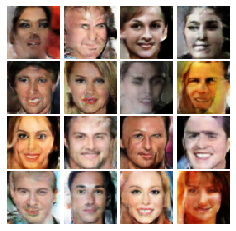


EPOCH:  16
Iter: 14800, D: 0.05721, G:0.5163


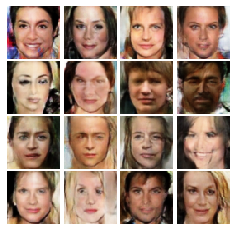


Iter: 15000, D: 0.07989, G:0.2835


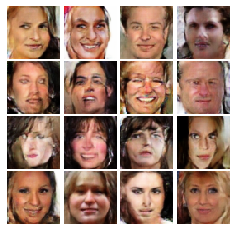


Iter: 15200, D: 0.2216, G:0.6224


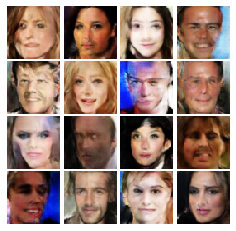


Iter: 15400, D: 0.1549, G:0.5164


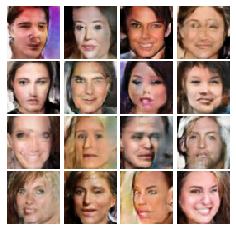


Iter: 15600, D: 0.03167, G:0.5028


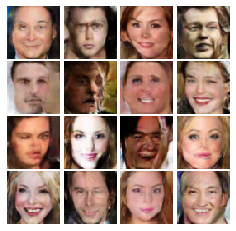


EPOCH:  17
Iter: 15800, D: 0.02307, G:0.3533


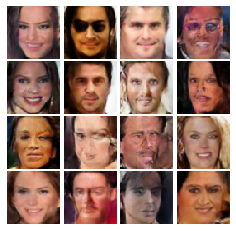


Iter: 16000, D: 0.02757, G:0.4628


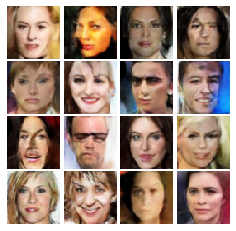


Iter: 16200, D: 0.0528, G:0.6121


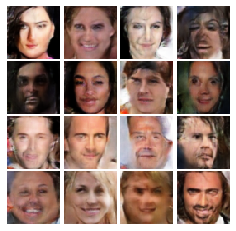


Iter: 16400, D: 0.03446, G:0.6219


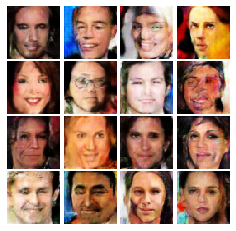


Iter: 16600, D: 0.07528, G:0.4863


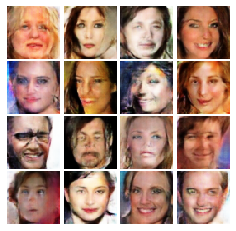


EPOCH:  18
Iter: 16800, D: 0.0877, G:0.445


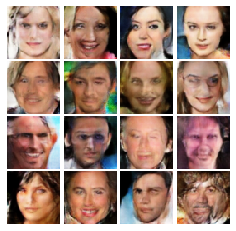


Iter: 17000, D: 0.01601, G:0.4766


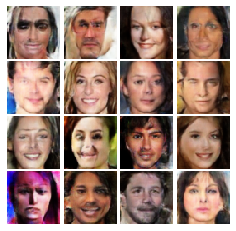


Iter: 17200, D: 0.1012, G:0.2202


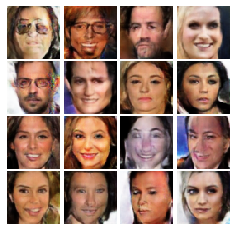


Iter: 17400, D: 0.07136, G:0.4442


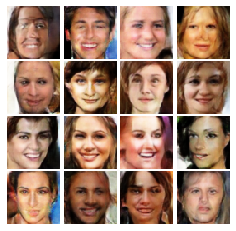


Iter: 17600, D: 0.02931, G:0.4241


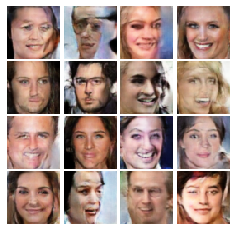


EPOCH:  19
Iter: 17800, D: 0.02656, G:0.4797


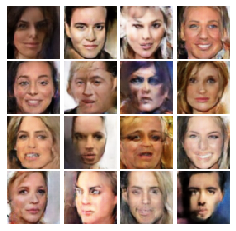


Iter: 18000, D: 0.06448, G:0.392


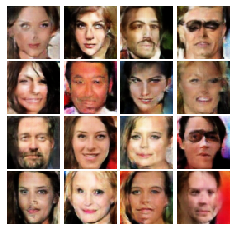


Iter: 18200, D: 0.03733, G:0.5455


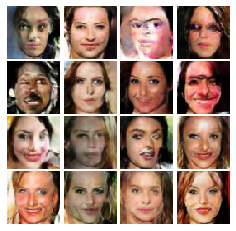


Iter: 18400, D: 0.04428, G:0.489


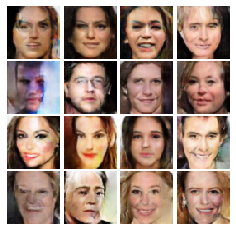


Iter: 18600, D: 0.1144, G:0.3463


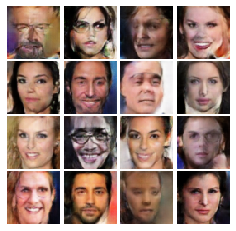


EPOCH:  20
Iter: 18800, D: 0.03591, G:0.5762


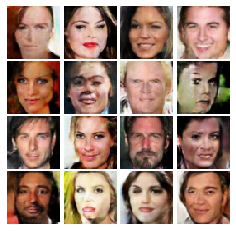


Iter: 19000, D: 0.04586, G:0.5365


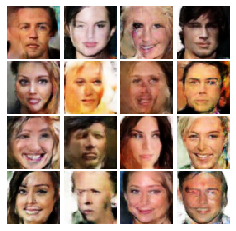


Iter: 19200, D: 0.02038, G:0.5746


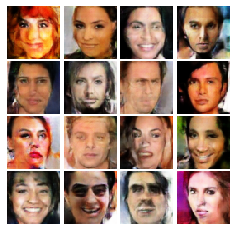


Iter: 19400, D: 0.04623, G:0.5703


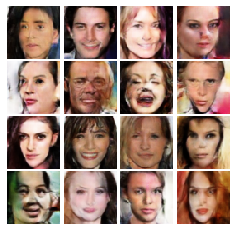


Iter: 19600, D: 0.3062, G:0.2733


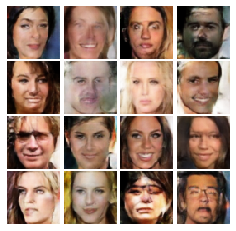

In [16]:
# ls-gan
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss, 
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=200,
          train_loader=celeba_loader_train, device=device)